# 

In [1]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import random
import math

### Passo 1: Carregar a imagem

In [2]:
# imagem = Image.open('playboy.png')
imagem = Image.open('lenna.jpg')

### Passo 2: Converter para escala de cinza

In [3]:
imagem_cinza = imagem.convert('L')

### Passo 3: Converter a imagem para um array NumPy

In [4]:
valores_pixels = np.array(imagem_cinza)

### Passo 4: Obter o array de valores 1D e normalizar de 0 a 1

In [5]:
valores_pixels_1d = valores_pixels.flatten() / 255
# valores_pixels_1d = valores_pixels.flatten() 

### Passo 5: Calcular a média e o desvio padrão dos valores dos pixels

In [6]:
media = np.mean(valores_pixels_1d)
desvio_padrao = np.std(valores_pixels_1d)

# Exibir os resultados
print("Tamanho da Imagem:", imagem_cinza.size)
print("Média:", media)
print("Desvio Padrão:", desvio_padrao)

Tamanho da Imagem: (512, 512)
Média: 0.48646373374789376
Desvio Padrão: 0.18716595137992745


### Passo 6: Construir e normalizar o vetor x com níveis de cinza de -1 até 1

In [7]:
# x = np.linspace(-1, 1, 511)
x = np.linspace(-1, 1, 511)
print(x)

[-1.         -0.99607843 -0.99215686 -0.98823529 -0.98431373 -0.98039216
 -0.97647059 -0.97254902 -0.96862745 -0.96470588 -0.96078431 -0.95686275
 -0.95294118 -0.94901961 -0.94509804 -0.94117647 -0.9372549  -0.93333333
 -0.92941176 -0.9254902  -0.92156863 -0.91764706 -0.91372549 -0.90980392
 -0.90588235 -0.90196078 -0.89803922 -0.89411765 -0.89019608 -0.88627451
 -0.88235294 -0.87843137 -0.8745098  -0.87058824 -0.86666667 -0.8627451
 -0.85882353 -0.85490196 -0.85098039 -0.84705882 -0.84313725 -0.83921569
 -0.83529412 -0.83137255 -0.82745098 -0.82352941 -0.81960784 -0.81568627
 -0.81176471 -0.80784314 -0.80392157 -0.8        -0.79607843 -0.79215686
 -0.78823529 -0.78431373 -0.78039216 -0.77647059 -0.77254902 -0.76862745
 -0.76470588 -0.76078431 -0.75686275 -0.75294118 -0.74901961 -0.74509804
 -0.74117647 -0.7372549  -0.73333333 -0.72941176 -0.7254902  -0.72156863
 -0.71764706 -0.71372549 -0.70980392 -0.70588235 -0.70196078 -0.69803922
 -0.69411765 -0.69019608 -0.68627451 -0.68235294 -0.

### Funçôes para adicionar ruídos

In [8]:
# Função para calcular a distribuição Gama

def erlang_pdf():
    a = 15
    b = 3
    pdf_values = []
    for z in x:
        if z < 0:
            pdf_values.append(0)
        else:
            numerator = (a ** b) * (z ** (b - 1)) * np.exp(-a * z)
            denominator = math.factorial(b - 1)
            # denominator = math.gamma(b)
            pdf_values.append((numerator / denominator))
    return pdf_values


### Passo 7: Calcular a função de densidade de probabilidade (FDP) para o ruído gaussiano

In [9]:
# Calcula e substitui os valores
pdf_values = erlang_pdf()
print(pdf_values)


[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.0, 0.02446902622460731, 0.09228475073385152, 0.19577882937215269, 0.32816817840062, 0.4834702532526877, 0.6564256094083311, 0.8424271617898496, 1.037455603599066, 1.238020486759375, 1.4411065043303257, 1.6441245506448472, 1.84486716

### Passo 8: Calcular a função densidade acumulada (FDA) como a soma cumulativa da FDP

In [10]:
fda_values = np.cumsum(pdf_values)

### Passo 9: Normalizar a FDA para que o último valor seja 1

In [11]:
fda_values /= fda_values[-1]

### Plotando os graficos

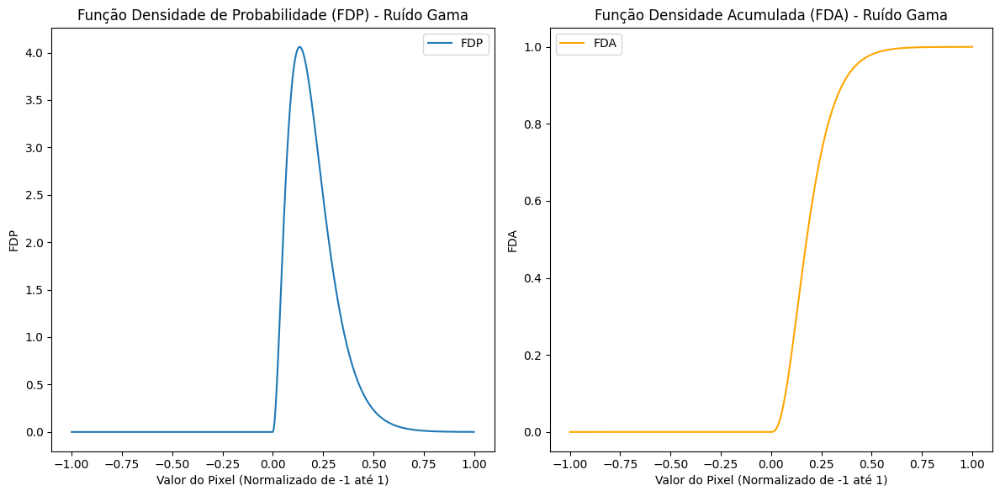

In [12]:
# Plotar a FDP e a FDA
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(x, pdf_values, label="FDP")
plt.title("Função Densidade de Probabilidade (FDP) - Ruído Gama")
plt.xlabel("Valor do Pixel (Normalizado de -1 até 1)")
plt.ylabel("FDP")
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(x, fda_values, label="FDA", color="orange")
plt.title("Função Densidade Acumulada (FDA) - Ruído Gama")
plt.xlabel("Valor do Pixel (Normalizado de -1 até 1)")
plt.ylabel("FDA")
plt.legend()

plt.tight_layout()
plt.show()

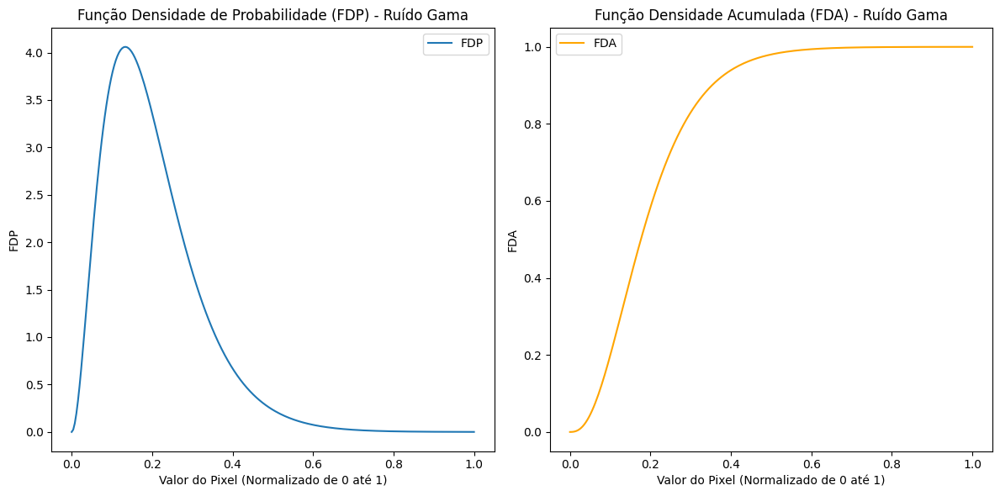

In [13]:
import matplotlib.pyplot as plt

# Filtrando os valores de x, pdf_values e fda_values para x >= 0
x_filtered = [val for val in x if val >= 0]
pdf_values_filtered = [pdf for val, pdf in zip(x, pdf_values) if val >= 0]
fda_values_filtered = [fda for val, fda in zip(x, fda_values) if val >= 0]

# Plotar a FDP e a FDA
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(x_filtered, pdf_values_filtered, label="FDP")
plt.title("Função Densidade de Probabilidade (FDP) - Ruído Gama")
plt.xlabel("Valor do Pixel (Normalizado de 0 até 1)")
plt.ylabel("FDP")
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(x_filtered, fda_values_filtered, label="FDA", color="orange")
plt.title("Função Densidade Acumulada (FDA) - Ruído Gama")
plt.xlabel("Valor do Pixel (Normalizado de 0 até 1)")
plt.ylabel("FDA")
plt.legend()

plt.tight_layout()
plt.show()


# Passo 10: Gerar valores de FDA aleatórios e modificar os valores dos pixels

In [14]:
num = np.random.uniform(0, 1, valores_pixels.size)

### Encontrndo nivel de cinza

In [15]:
def encontrar_nivel_cinza(fda, x, valor_fda_desejado):
    # Encontra o índice do valor de FDA mais próximo
    idx = np.searchsorted(fda, valor_fda_desejado, side='left')
    # Se o índice estiver fora dos limites, ajusta
    if idx >= len(x):
        idx = len(x) - 1
    if idx < 0:
        idx = 0
    return x[idx]

### Criação de um novo array para armazenar os valores de pixels modificados

In [16]:
valores_pixels_1d_modificado = valores_pixels_1d.copy()

for i in range(valores_pixels.size):
    # val = num[i]

    valor_fda_desejado = np.random.uniform(0, 1) 
    
    # Encontrar o valor de nível de cinza para um valor específico de FDA
    nivel_cinza = encontrar_nivel_cinza(fda_values, x, valor_fda_desejado) * 0.2

    print(f"Nível de cinza correspondente ao valor FDA = {valor_fda_desejado}: {nivel_cinza}")

    # valores_pixels_1d_modificado[i] = nivel_cinza
    
    # if valores_pixels_1d_modificado[i] + nivel_cinza > 1:
    #      valores_pixels_1d_modificado[i] -= nivel_cinza
    # else:
    #     valores_pixels_1d_modificado[i] += nivel_cinza
    
    valores_pixels_1d_modificado[i] += nivel_cinza
    
    # if valores_pixels_1d_modificado[i] > 1:
    #      valores_pixels_1d_modificado[i] = 1
    # if valores_pixels_1d_modificado[i] < 0:
    #     valores_pixels_1d_modificado[i] = 0

valores_pixels_1d_modificado = (valores_pixels_1d_modificado * 255)

Nível de cinza correspondente ao valor FDA = 0.7153485031396691: 0.049411764705882356
Nível de cinza correspondente ao valor FDA = 0.8467355780695702: 0.06274509803921569
Nível de cinza correspondente ao valor FDA = 0.4364015939921858: 0.03215686274509801
Nível de cinza correspondente ao valor FDA = 0.4633367157524475: 0.03372549019607845
Nível de cinza correspondente ao valor FDA = 0.7111097234912501: 0.049411764705882356
Nível de cinza correspondente ao valor FDA = 0.6878812846813053: 0.04705882352941178
Nível de cinza correspondente ao valor FDA = 0.35546830134740404: 0.02823529411764705
Nível de cinza correspondente ao valor FDA = 0.600573572761385: 0.04156862745098038
Nível de cinza correspondente ao valor FDA = 0.747874555068745: 0.051764705882352935
Nível de cinza correspondente ao valor FDA = 0.9744437134674744: 0.09568627450980394
Nível de cinza correspondente ao valor FDA = 0.9205083683349597: 0.07529411764705883
Nível de cinza correspondente ao valor FDA = 0.3643098758102726

### Passo 11: Converter o array 1D modificado de volta para uma imagem

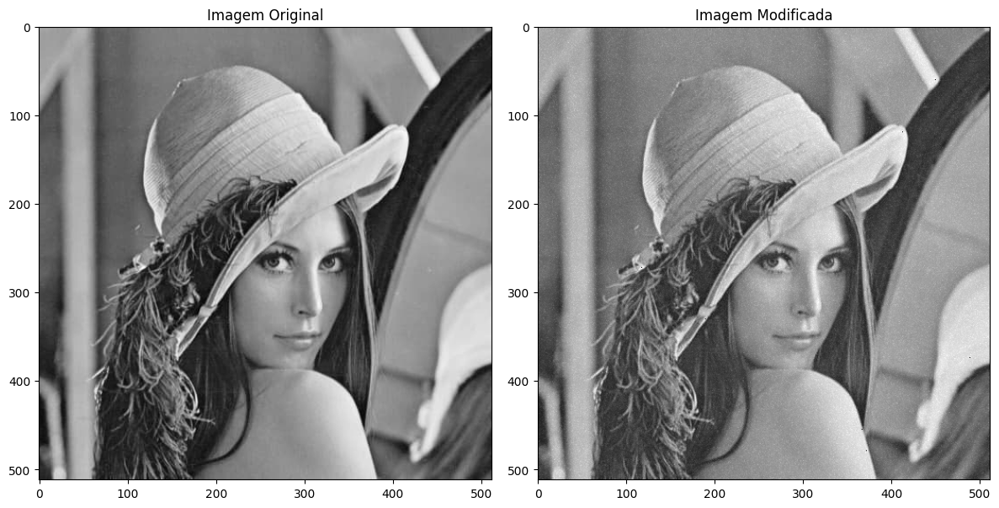

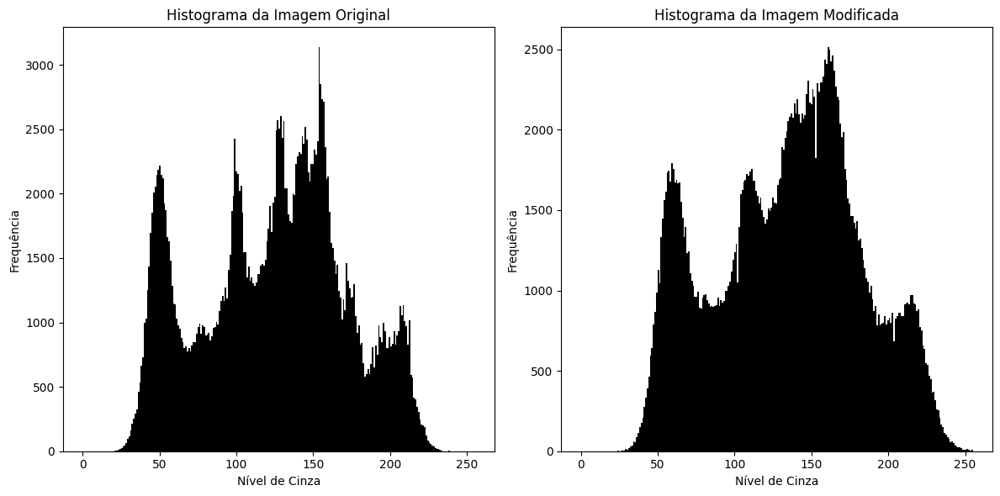

In [17]:
valores_pixels_modificado = valores_pixels_1d_modificado.reshape(valores_pixels.shape)
imagem_modificada = Image.fromarray(valores_pixels_modificado.astype(np.uint8))

# Exibir a imagem original e modificada lado a lado
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(imagem_cinza, cmap="gray")
plt.title("Imagem Original")

plt.subplot(1, 2, 2)
plt.imshow(imagem_modificada, cmap="gray")
plt.title("Imagem Modificada")

plt.tight_layout()
plt.show()

# Plotar os histogramas da imagem original e modificada
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.hist(valores_pixels.flatten(), bins=256, range=(0, 255), color='black')
plt.title("Histograma da Imagem Original")
plt.xlabel("Nível de Cinza")
plt.ylabel("Frequência")

plt.subplot(1, 2, 2)
plt.hist(valores_pixels_modificado.flatten(), bins=256, range=(0, 255), color='black')
plt.title("Histograma da Imagem Modificada")
plt.xlabel("Nível de Cinza")
plt.ylabel("Frequência")

plt.tight_layout()
plt.show()